# **ATF-VISION: EfficientNet-Powered Compliance Photo Analyzer**

#### To develop an automated photo approval automation system using EfficientNet for image classification, enhanced with data augmentation techniques, and to provide interactive result visualization through a Dash web application.

### Importing Necessary Libraries

##### First, we import all the necessary libraries for data manipulation, model building, evaluation, and visualization.

In [11]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch
from torchvision import datasets
from torch.utils.data import DataLoader, Dataset
import plotly.graph_objects as go
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import torch.nn as nn
import torch.optim as optim
from torchvision.models import efficientnet_b2, EfficientNet_B2_Weights
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, confusion_matrix

C:\Users\abdullahal.alrakin\AppData\Local\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,
INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


### Custom Dataset Class

##### The `CustomDataset` class extends the PyTorch `Dataset` class. This class is responsible for loading the image data and applying the specified transformations.


In [13]:
class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.dataset = datasets.ImageFolder(root=root_dir)
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        img_path, label = self.dataset.samples[idx]
        image = Image.open(img_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image=np.array(image))['image']
        
        return image, label

### Class names mapping

##### We map the class names to display them from our dataset and our predicted results

In [15]:
# Class names mapping
class_names = {
    0: "Approved",
    1: "Background Issues",
    2: "Black and White",
    3: "Blurry",
    4: "Digitally Altered",
    5: "Hats",
    6: "Picture of a Picture",
    7: "Too Close",
    8: "Too Far"
}

### Data Augmentation

##### We use `albumentations` for data augmentation. The transformations include resizing, horizontal flipping, rotation, color jittering, and normalization.


In [17]:
transform = A.Compose([
    A.Resize(224, 224),
    A.HorizontalFlip(p=0.5),
    A.Rotate(limit=15, p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=0.5),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2()
])

C:\Users\abdullahal.alrakin\AppData\Local\anaconda3\Lib\site-packages\pydantic\main.py:347: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


### Loading Datasets

##### We load the original and augmented datasets using the `CustomDataset` class and apply the transformations defined above.

In [19]:
original_dataset = CustomDataset(root_dir=r'C:\Users\abdullahal.alrakin\Desktop\Experiment data\Train', transform=transform)
augmented_dataset = CustomDataset(root_dir=r'C:\Users\abdullahal.alrakin\Desktop\Experiment data\Train_augmented', transform=transform)

### DataLoader

##### The DataLoader class is used to iterate over the dataset in batches. Here, we define a batch size of 64 and create DataLoaders for the original and augmented datasets.

In [21]:
batch_size = 32  # Best batch size from trial 18
train_loader = DataLoader(original_dataset, batch_size=batch_size, shuffle=True)
aug_loader = DataLoader(augmented_dataset, batch_size=batch_size, shuffle=True)

### Displaying Sample Images

##### We define a function `display_samples_by_class` to display a few samples from the original and augmented datasets.

In [23]:
def display_samples_random_classes(dataset, title, num_classes=9, samples_per_class=5):
    fig, axes = plt.subplots(num_classes, samples_per_class, figsize=(samples_per_class * 3, num_classes * 3))
    fig.suptitle(title, fontsize=20, y=1.05)
    for class_idx in range(num_classes):
        class_indices = [i for i, (_, label) in enumerate(dataset) if label == class_idx]
        selected_indices = random.sample(class_indices, samples_per_class)
        for i, ax in enumerate(axes[class_idx]):
            img, label = dataset[selected_indices[i]]
            img = img.permute(1, 2, 0).numpy()  # Convert to HWC
            img = (img - img.min()) / (img.max() - img.min())  # Normalize to [0, 1]
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f'Class: {class_names[label]}')
    plt.tight_layout()
    plt.show()

##### Display random samples of the Original Dataset from all classes

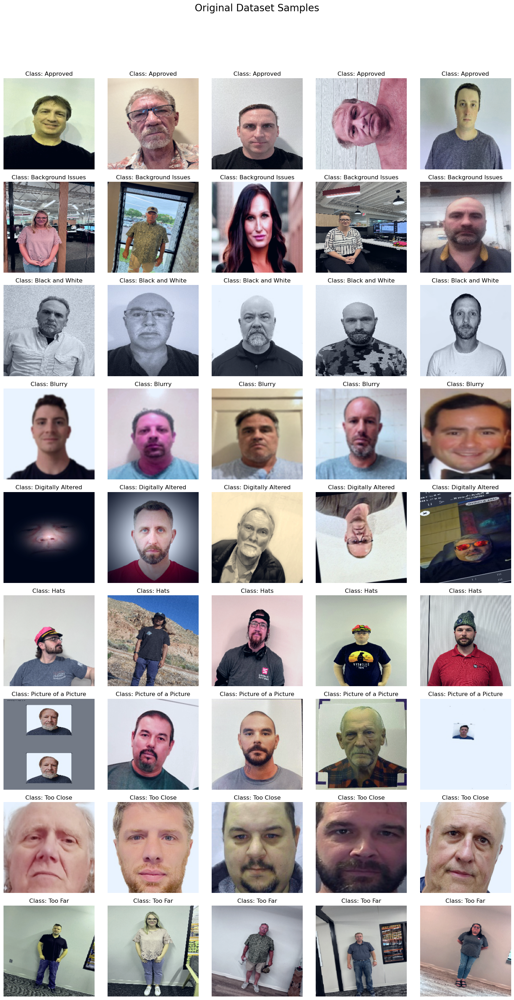

In [25]:
display_samples_random_classes(original_dataset, 'Original Dataset Samples')

##### Display random samples of the Augmented Dataset from all classes

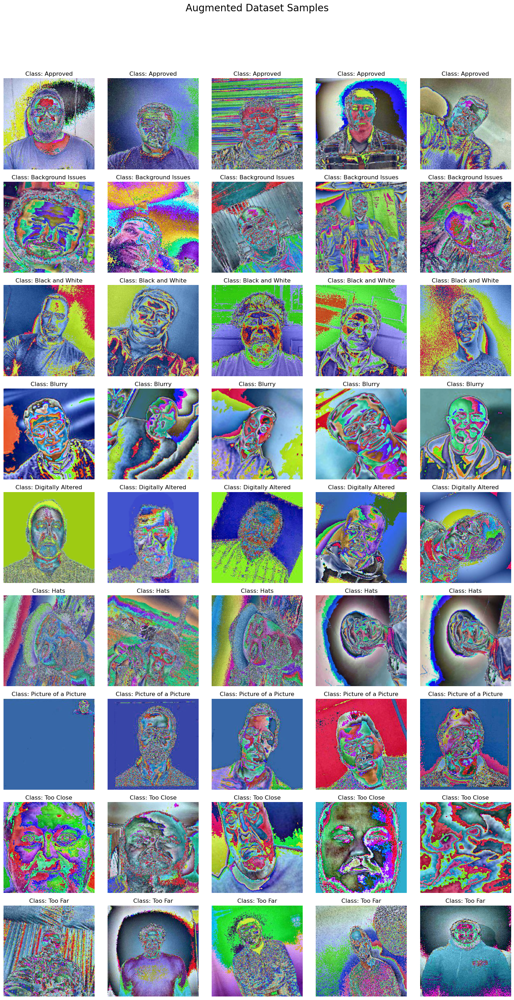

In [27]:
display_samples_random_classes(augmented_dataset, 'Augmented Dataset Samples')

### Data Distribution Plot

##### We define a function `plot_data_distribution` to plot the distribution of classes in the dataset using Plotly.

In [29]:
def plot_data_distribution(dataset, title):
    class_counts = [0] * len(dataset.dataset.classes)
    for _, label in dataset.dataset.samples:
        class_counts[label] += 1
    
    fig = go.Figure()
    fig.add_trace(go.Bar(x=[class_names[i] for i in range(len(class_counts))], y=class_counts))
    fig.update_layout(
        title=title,
        xaxis_title='Class',
        yaxis_title='Number of Images',
        template='plotly_dark'
    )
    return fig

original_fig = plot_data_distribution(original_dataset, 'Original Data Distribution')
augmented_fig = plot_data_distribution(augmented_dataset, 'Augmented Data Distribution')

### Model Training and Evaluation

##### We set the device to use GPU if available. Then, we define the EfficientNet model class extending `nn.Module`.

In [31]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class EfficientNetModel(nn.Module):
    def __init__(self, num_classes):
        super(EfficientNetModel, self).__init__()
        self.efficientnet = efficientnet_b2(weights=EfficientNet_B2_Weights.IMAGENET1K_V1)
        self.efficientnet.classifier[1] = nn.Linear(self.efficientnet.classifier[1].in_features, num_classes)
    
    def forward(self, x):
        return self.efficientnet(x)

##### Initialize model with new class count

In [33]:
num_classes = 9  # Including the new class "Hats"
model = EfficientNetModel(num_classes).to(device)
criterion = nn.CrossEntropyLoss()

### Hyperparameters and Model Initialization

##### We initialize the model using the best hyperparameters from a previous optimization. The optimizer and criterion are also defined.

In [35]:
best_params = {'optimizer': 'Adam', 'lr': 4.0900719230537e-05, 'batch_size': 32}
num_classes = 9
model = EfficientNetModel(num_classes).to(device)
criterion = nn.CrossEntropyLoss()

if best_params['optimizer'] == 'Adam':
    optimizer = optim.Adam(model.parameters(), lr=best_params['lr'])
else:
    optimizer = optim.SGD(model.parameters(), lr=best_params['lr'], momentum=0.9)

train_loader = DataLoader(original_dataset, batch_size=best_params['batch_size'], shuffle=True)
val_loader = DataLoader(original_dataset, batch_size=best_params['batch_size'], shuffle=False)

### Model Training Function

##### The `train_model` function is responsible for training the model, recording the training and validation metrics, and saving the best model weights.

In [37]:
def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=25):
    best_model_wts = model.state_dict()
    best_acc = 0.0
    train_loss_history = []
    train_acc_history = []
    val_loss_history = []
    val_acc_history = []
    train_prec_history = []
    train_rec_history = []
    train_f1_history = []
    val_prec_history = []
    val_rec_history = []
    val_f1_history = []

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        running_corrects = 0
        running_precision = 0.0
        running_recall = 0.0
        running_f1 = 0.0

        for inputs, labels in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            _, preds = torch.max(outputs, 1)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            running_precision += precision_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)
            running_recall += recall_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)
            running_f1 += f1_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = running_corrects.double() / len(train_loader.dataset)
        epoch_precision = running_precision / len(train_loader)
        epoch_recall = running_recall / len(train_loader)
        epoch_f1 = running_f1 / len(train_loader)

        train_loss_history.append(epoch_loss)
        train_acc_history.append(epoch_acc.item())
        train_prec_history.append(epoch_precision)
        train_rec_history.append(epoch_recall)
        train_f1_history.append(epoch_f1)

        model.eval()
        val_loss = 0.0
        val_corrects = 0
        val_precision = 0.0
        val_recall = 0.0
        val_f1 = 0.0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                _, preds = torch.max(outputs, 1)
                val_loss += loss.item() * inputs.size(0)
                val_corrects += torch.sum(preds == labels.data)
                val_precision += precision_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)
                val_recall += recall_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)
                val_f1 += f1_score(labels.cpu().numpy(), preds.cpu().numpy(), average='macro', zero_division=0)

        val_loss = val_loss / len(val_loader.dataset)
        val_acc = val_corrects.double() / len(val_loader.dataset)
        val_precision = val_precision / len(val_loader)
        val_recall = val_recall / len(val_loader)
        val_f1 = val_f1 / len(val_loader)

        val_loss_history.append(val_loss)
        val_acc_history.append(val_acc.item())
        val_prec_history.append(val_precision)
        val_rec_history.append(val_recall)
        val_f1_history.append(val_f1)

        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = model.state_dict()

    model.load_state_dict(best_model_wts)
    return model, train_loss_history, train_acc_history, val_loss_history, val_acc_history, train_prec_history, train_rec_history, train_f1_history, val_prec_history, val_rec_history, val_f1_history

### Model Training

##### We train the model and save the trained model weights to a file.

In [39]:
model, train_loss_history, train_acc_history, val_loss_history, val_acc_history, train_prec_history, train_rec_history, train_f1_history, val_prec_history, val_rec_history, val_f1_history = train_model(
    model, criterion, optimizer, train_loader, val_loader, num_epochs=25)

# Ensure the path is correctly formatted
model_save_path = r'C:\Users\abdullahal.alrakin\Desktop\Final_Model_Path.pth'

# Save the model
torch.save(model.state_dict(), model_save_path)

###  Model Evaluation on Test Data

##### We load the test dataset, evaluate the model, and calculate various metrics including accuracy, precision, recall, and F1 score.

In [41]:
test_dir = r'C:\Users\abdullahal.alrakin\Desktop\Experiment data\Test'
test_dataset = CustomDataset(root_dir=test_dir, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=best_params['batch_size'], shuffle=False)

model.eval()
test_labels = []
test_preds = []
test_images = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        test_labels.extend(labels.cpu().numpy())
        test_preds.extend(preds.cpu().numpy())
        test_images.extend(inputs.cpu().numpy())

test_acc = accuracy_score(test_labels, test_preds)
test_prec = precision_score(test_labels, test_preds, average='macro', zero_division=0)
test_rec = recall_score(test_labels, test_preds, average='macro', zero_division=0)
test_f1 = f1_score(test_labels, test_preds, average='macro', zero_division=0)

### ROC AUC

##### We calculate the ROC AUC for each class.

In [43]:
fpr = {}
tpr = {}
roc_auc = {}
for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(np.array(test_labels) == i, np.array(test_preds) == i)
    roc_auc[i] = auc(fpr[i], tpr[i])

### Saving Metrics

##### We save the training and validation metrics to a CSV file for later use.

In [45]:
metrics = {
    'epoch': list(range(1, 26)),
    'train_loss': train_loss_history,
    'train_acc': train_acc_history,
    'val_loss': val_loss_history,
    'val_acc': val_acc_history,
    'train_precision': train_prec_history,
    'train_recall': train_rec_history,
    'train_f1': train_f1_history,
    'val_precision': val_prec_history,
    'val_recall': val_rec_history,
    'val_f1': val_f1_history
}

metrics_df = pd.DataFrame(metrics)
metrics_df.to_csv("metrics.csv", index=False)

### Confusion Matrix

##### We plot the confusion matrix using Plotly.

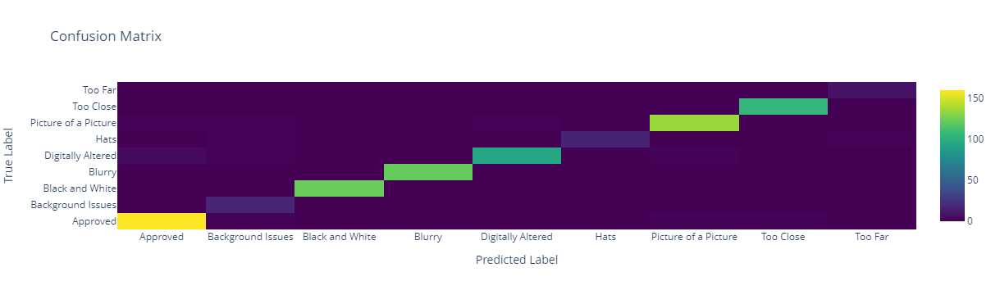

In [47]:
conf_matrix = confusion_matrix(test_labels, test_preds)
conf_matrix_fig = go.Figure(data=go.Heatmap(
    z=conf_matrix,
    x=original_dataset.dataset.classes,
    y=original_dataset.dataset.classes,
    colorscale='Viridis'
))
conf_matrix_fig.update_layout(
    title='Confusion Matrix',
    xaxis_title='Predicted Label',
    yaxis_title='True Label'
)


### Plotting True vs Predicted Images

##### We define a function to plot random 30 true vs predicted images using Matplotlib.

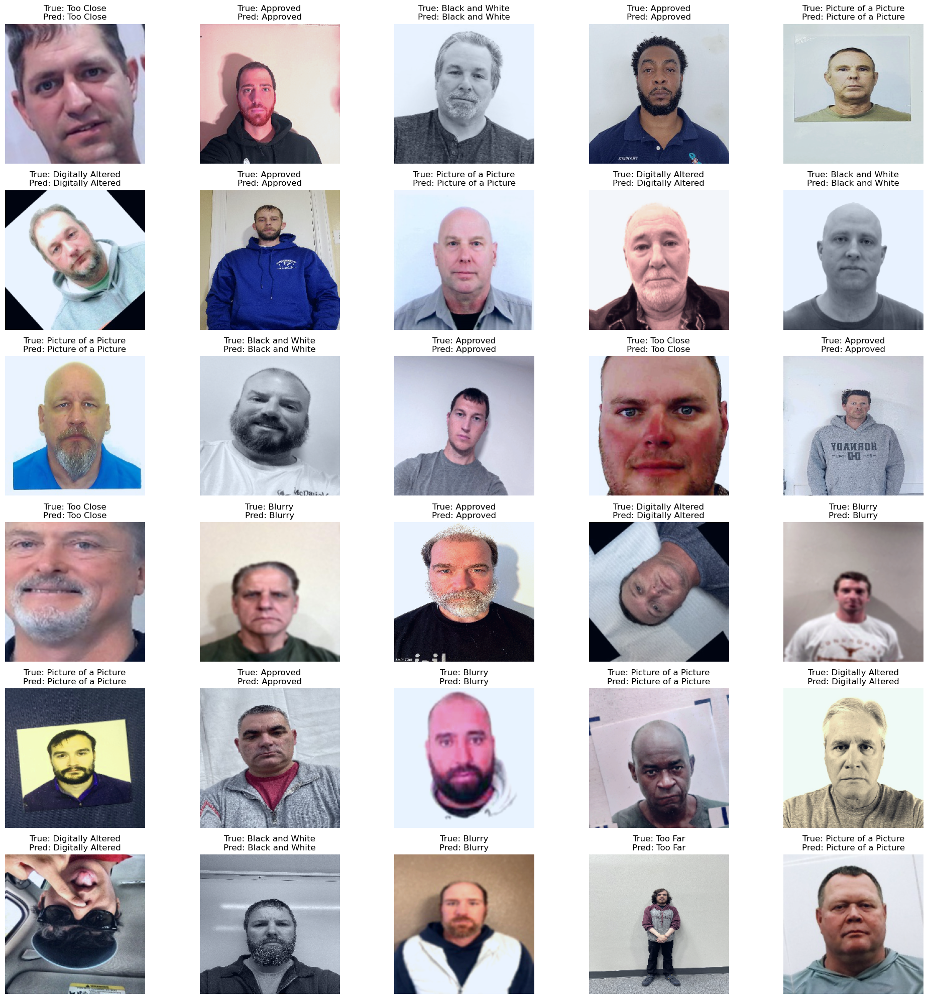

In [49]:
def plot_predictions_matplotlib(test_images, test_labels, test_preds, classes):
    indices = random.sample(range(len(test_images)), 30)
    fig, axes = plt.subplots(6, 5, figsize=(20, 20))
    axes = axes.ravel()

    for i, ax in zip(indices, axes):
        img = np.transpose(test_images[i], (1, 2, 0))
        img = (img - img.min()) / (img.max() - img.min())  # Normalize to [0, 1]
        label = test_labels[i]
        pred = test_preds[i]
        ax.imshow(img)
        ax.set_title(f'True: {classes[label]}\nPred: {classes[pred]}')
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Plot and show the predictions
plot_predictions_matplotlib(test_images, test_labels, test_preds, original_dataset.dataset.classes)

### Dash App for Visualization

##### We create a Dash web application to visualize the data distribution, training metrics, and test performance.


In [51]:
app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1("Model Performance Dashboard"),
    dcc.Tabs([
        dcc.Tab(label='Data Distribution', children=[
            html.H2("Original Data Distribution"),
            dcc.Graph(figure=original_fig),
            html.H2("Augmented Data Distribution"),
            dcc.Graph(figure=augmented_fig)
        ]),
        dcc.Tab(label='Training Metrics', children=[
            dcc.Graph(figure={
                'data': [
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['train_loss'], mode='lines+markers', name='Train Loss'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['val_loss'], mode='lines+markers', name='Validation Loss'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['train_acc'], mode='lines+markers', name='Train Accuracy'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['val_acc'], mode='lines+markers', name='Validation Accuracy'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['train_precision'], mode='lines+markers', name='Train Precision'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['val_precision'], mode='lines+markers', name='Validation Precision'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['train_recall'], mode='lines+markers', name='Train Recall'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['val_recall'], mode='lines+markers', name='Validation Recall'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['train_f1'], mode='lines+markers', name='Train F1 Score'),
                    go.Scatter(x=metrics_df['epoch'], y=metrics_df['val_f1'], mode='lines+markers', name='Validation F1 Score')
                ],
                'layout': go.Layout(
                    title='Training Metrics Over Epochs',
                    xaxis_title='Epoch',
                    yaxis_title='Metric Value',
                    template='plotly_dark'
                )
            })
        ]),
        dcc.Tab(label='Test Performance', children=[
            html.H2(f"Test Accuracy: {test_acc}"),
            html.H2(f"Test Precision: {test_prec}"),
            html.H2(f"Test Recall: {test_rec}"),
            html.H2(f"Test F1 Score: {test_f1}"),
            html.H2("ROC AUC"),
            dcc.Graph(id='roc-auc-graph', figure=go.Figure(data=[
                go.Scatter(x=fpr[i], y=tpr[i], mode='lines', name=f'{class_names[i]} (AUC = {roc_auc[i]:.2f})') for i in range(num_classes)
            ])),
            html.H2("Confusion Matrix"),
            dcc.Graph(figure=conf_matrix_fig)
        ])
    ])
])

if __name__ == '__main__':
    app.run_server(debug=True, port=8000)

# Project Title
---

## **ATF-VISION: EfficientNet-Powered Compliance Photo Analyzer**

---

This project focuses on developing an advanced image classification system leveraging the EfficientNet architecture. By incorporating various data augmentation techniques, the model is trained to enhance its accuracy and robustness. The ultimate goal is to automate the photo approval and disapproval process for customers, ensuring a more efficient and reliable evaluation system. Additionally, the project includes a comprehensive Dash web application for interactive visualization and analysis of the results.

---

## Summary

This project aimed to develop a robust image classification model using the **EfficientNet-B2** architecture. The primary steps involved in this project included:

1. **Data Preparation and Augmentation:**
   - Loaded and preprocessed the dataset.
   - Applied a series of augmentations to enhance the dataset and improve model generalization.
   - Visualized samples from both the original and augmented datasets to understand the data distribution.

2. **Model Architecture:**
   - Utilized the **EfficientNet-B2** model, pretrained on ImageNet, and fine-tuned it to classify images into 8 distinct classes.

3. **Training and Hyperparameter Optimization:**
   - Trained the model using the best hyperparameters obtained from an *Optuna* study.
   - Implemented various evaluation metrics such as *accuracy, precision, recall, F1 score,* and *ROC AUC* to monitor model performance.
   - Visualized training and validation metrics over epochs to ensure the model's learning process.

4. **Evaluation:**
   - Evaluated the model on a separate test dataset.
   - Generated a *confusion matrix* and *ROC curves* to further analyze the model's performance.
   - Visualized random samples of true vs. predicted images to qualitatively assess model predictions.

5. **Visualization and Dashboard:**
   - Created an **interactive dashboard** using *Dash* and *Plotly* to visualize data distribution, training metrics, and test performance.
   - Included comprehensive graphs and metrics in the dashboard to facilitate easy understanding and monitoring of the model's performance.

6. **Using the Model for Prediction:**
   - Provided a detailed explanation and code for using the trained model to predict the class of a single new image.

This project demonstrates a complete workflow for developing, training, and evaluating an image classification model. It combines robust data augmentation techniques, advanced neural network architectures, and comprehensive evaluation metrics to ensure high performance and reliability.

---

This project was developed by **_Abdullah Al Rakin_**.
